In [1]:
!pip install roboflow

import os
from roboflow import Roboflow

rf = Roboflow(api_key="")
project = rf.workspace("diploma-wdwcx").project("products_sam")
version = project.version(8)
dataset = version.download("sam2")

# rename dataset.location to "data"
os.rename(dataset.location, "/kaggle/working/products_sam-3")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.4 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.10.0 requires tensorflow==2.17.0, but you have tensorflow 2.17.1 which is incompatible.
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to products_sam-8 in sam2:: 100%|██████████| 805/805 [00:00<00:00, 5635.07it/s]


In [2]:
!git clone https://github.com/facebookresearch/sam2.git

Cloning into 'sam2'...
remote: Enumerating objects: 1070, done.
remote: Total 1070 (delta 0), reused 0 (delta 0), pack-reused 1070 (from 1)
Receiving objects: 100% (1070/1070), 134.70 MiB | 11.54 MiB/s, done.
Resolving deltas: 100% (376/376), done.


In [3]:
#!wget -O /kaggle/working/sam2/sam2/configs/train.yaml 'https://drive.usercontent.google.com/download?id=11cmbxPPsYqFyWq87tmLgBAQ6OZgEhPG3'

In [4]:
!wget -O /kaggle/working/sam2/sam2/configs/train.yaml 'https://drive.usercontent.google.com/download?id=1yiP6yegW-afGgot4Fr_TMY0U-0PWdP0z'

--2025-01-28 21:37:24--  https://drive.usercontent.google.com/download?id=1yiP6yegW-afGgot4Fr_TMY0U-0PWdP0z
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 172.253.117.132, 2607:f8b0:400e:c0a::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|172.253.117.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11424 (11K) [application/octet-stream]
Saving to: ‘/kaggle/working/sam2/sam2/configs/train.yaml’

/kaggle/working/sam 100%[===================>]  11.16K  --.-KB/s    in 0s      

2025-01-28 21:37:27 (66.5 MB/s) - ‘/kaggle/working/sam2/sam2/configs/train.yaml’ saved [11424/11424]



In [5]:
%cd ./sam2/

/kaggle/working/sam2


Next, we are going to install SAM-2.

The SAM-2 installation process may take several minutes.

In [6]:
!pip install -e .[dev] -q

  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 37.8 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.9/74.9 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.9/359.9 kB 22.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 39.4 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.1/57.1 kB 3.6 MB/s 

In [7]:
!cd ./checkpoints && ./download_ckpts.sh

--2025-01-28 21:42:00--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_tiny.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.189.51, 3.163.189.96, 3.163.189.14, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.189.51|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 156008466 (149M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2.1_hiera_tiny.pt’

sam2.1_hiera_tiny.p 100%[===================>] 148.78M   237MB/s    in 0.6s    

2025-01-28 21:42:01 (237 MB/s) - ‘sam2.1_hiera_tiny.pt’ saved [156008466/156008466]

--2025-01-28 21:42:01--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_small.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.189.108, 3.163.189.14, 3.163.189.51, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.189.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 184416285 (176M) [applic

## Modify Dataset File Names

SAM-2.1 requires dataset file names to be in a particular format. Run the code snippet below to format your dataset file names as required.

In [8]:
# Script to rename roboflow filenames to something SAM 2.1 compatible.
# Maybe it is possible to remove this step tweaking sam2/sam2/configs/train.yaml.
import os
import re

FOLDER = "/kaggle/working/products_sam-3/train"

for filename in os.listdir(FOLDER):
    # Replace all except last dot with underscore
    new_filename = filename.replace(".", "_", filename.count(".") - 1)
    if not re.search(r"_\d+\.\w+$", new_filename):
        # Add an int to the end of base name
        new_filename = new_filename.replace(".", "_1.")
    os.rename(os.path.join(FOLDER, filename), os.path.join(FOLDER, new_filename))

## Start Training

You can now start training a SAM-2.1 model. The amount of time it will take to train the model will vary depending on the GPU you are using and the number of images in your dataset.

For the car part dataset of 38 images, training on an A100 GPU takes ~15 minutes.

In [9]:
!python training/train.py -c 'configs/train.yaml' --use-cluster 0 --num-gpus 1

###################### Train App Config ####################
scratch:
  resolution: 1024
  train_batch_size: 1
  num_train_workers: 10
  num_frames: 1
  max_num_objects: 3
  base_lr: 5.0e-06
  vision_lr: 3.0e-06
  phases_per_epoch: 1
  num_epochs: 40
dataset:
  img_folder: /kaggle/working/products_sam-3/train
  gt_folder: /kaggle/working/products_sam-3/train
  multiplier: 2
vos:
  train_transforms:
  - _target_: training.dataset.transforms.ComposeAPI
    transforms:
    - _target_: training.dataset.transforms.RandomHorizontalFlip
      consistent_transform: true
    - _target_: training.dataset.transforms.RandomAffine
      degrees: 25
      shear: 20
      image_interpolation: bilinear
      consistent_transform: true
    - _target_: training.dataset.transforms.RandomResizeAPI
      sizes: ${scratch.resolution}
      square: true
      consistent_transform: true
    - _target_: training.dataset.transforms.ColorJitter
      consistent_transform: true
      brightness: 0.1
      contras

You can visualize the model training graphs with Tensorboard:

In [10]:
%reload_ext tensorboard
%tensorboard --bind_all --logdir ./sam2_logs/

<IPython.core.display.Javascript object>

## Visualize Model Results

With a trained model ready, we can test the model on an image from our test set.

To assist with visualizing model predictions, we are going to use Roboflow supervision, an open source computer vision Python package with utilities for working with vision model outputs


In [11]:
!pip install supervision -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 5.5 MB/s eta 0:00:00


### Load SAM-2.1

In [12]:
import torch
from sam2.build_sam import build_sam2
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator
import supervision as sv
import os
import random
from PIL import Image
import numpy as np

# use bfloat16 for the entire notebook
# from Meta notebook
torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
if torch.cuda.get_device_properties(0).major >= 8:
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

checkpoint = "/kaggle/working/sam2/sam2_logs/configs/train.yaml/checkpoints/checkpoint.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_b+.yaml"
sam2 = build_sam2(model_cfg, checkpoint, device="cuda")
mask_generator = SAM2AutomaticMaskGenerator(sam2)

checkpoint_base = "/kaggle/working/sam2/checkpoints/sam2.1_hiera_base_plus.pt"
model_cfg_base = "configs/sam2.1/sam2.1_hiera_b+.yaml"
sam2_base = build_sam2(model_cfg_base, checkpoint_base, device="cuda")
mask_generator_base = SAM2AutomaticMaskGenerator(sam2_base)

### Run Inference on an Image in Automatic Mask Generation Mode

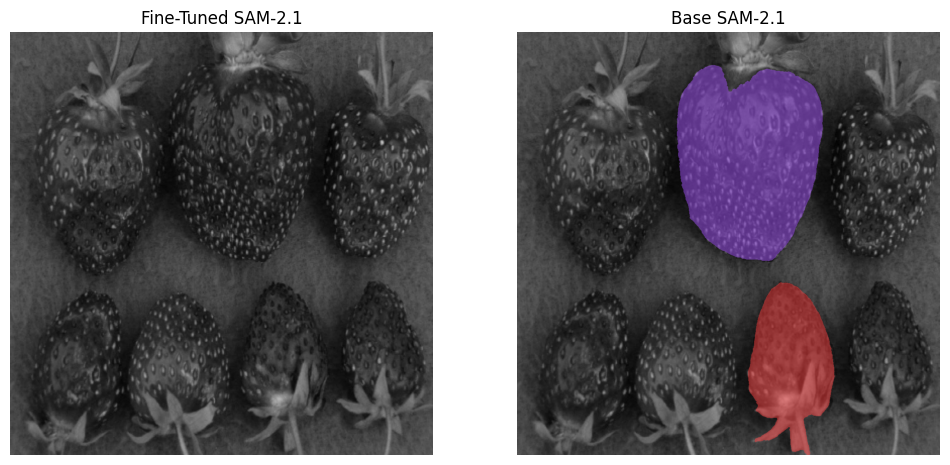

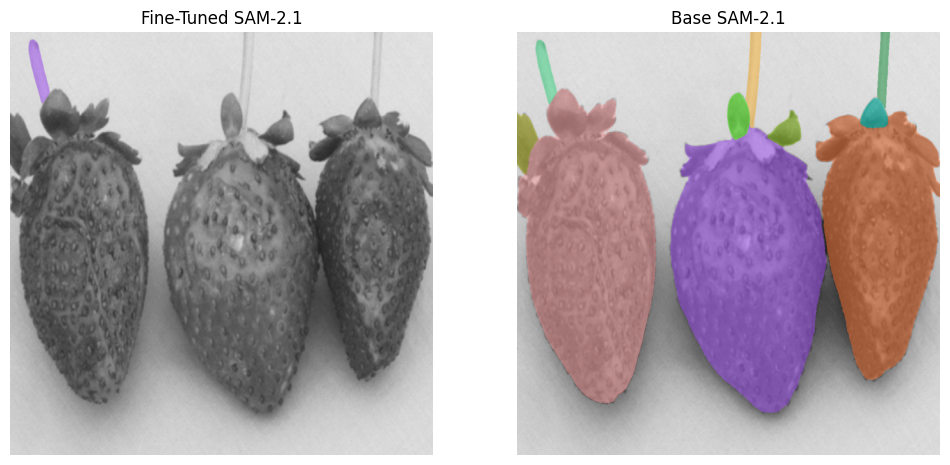

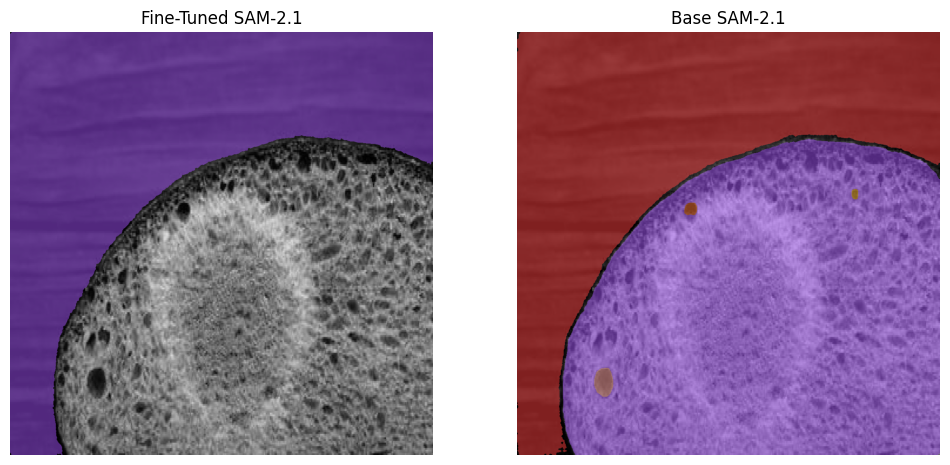

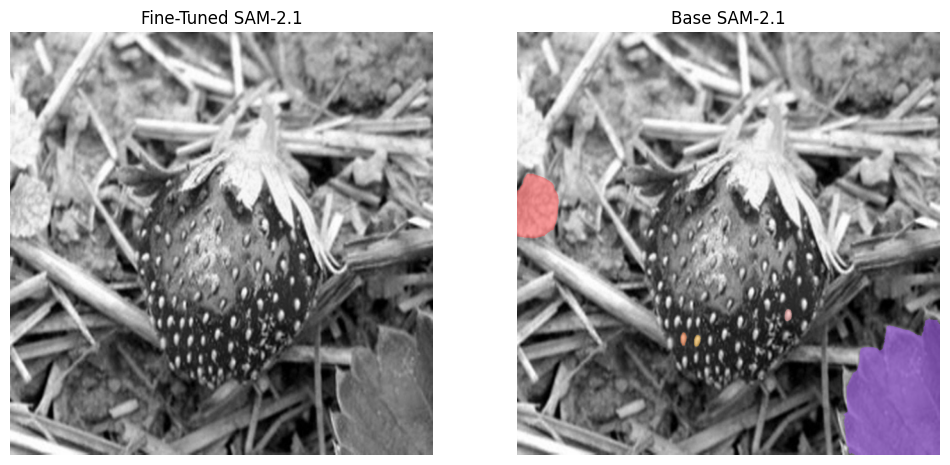

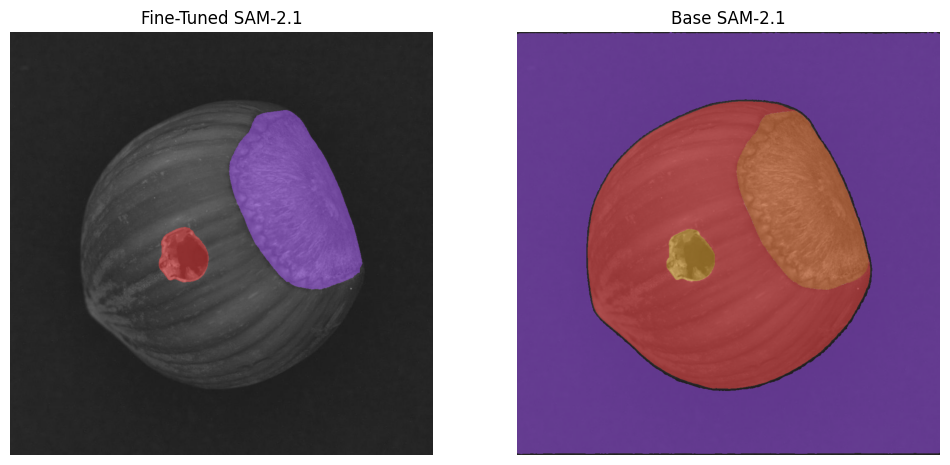

...

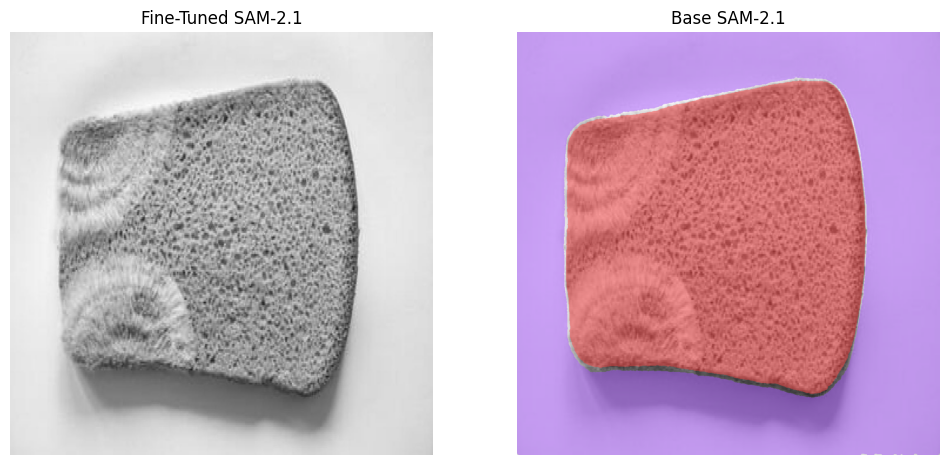

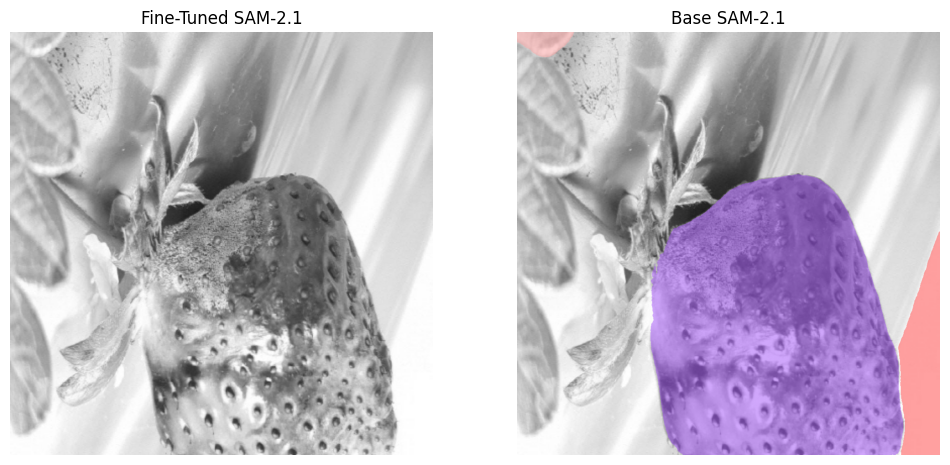

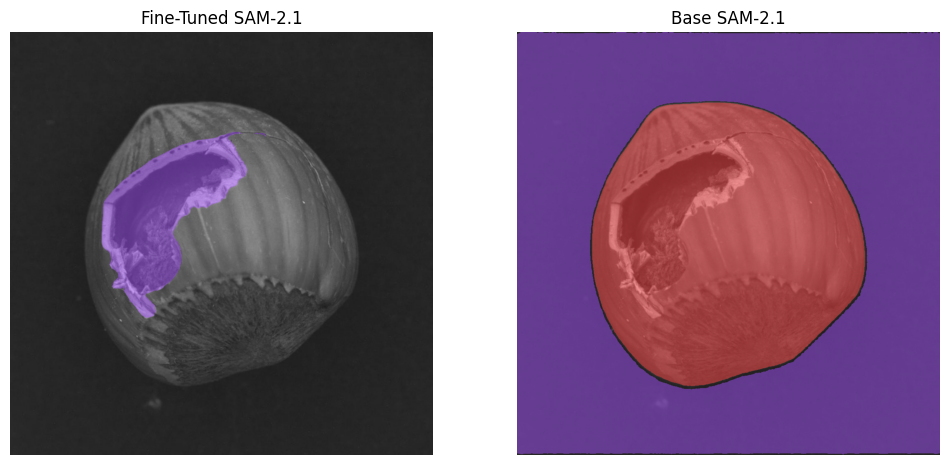

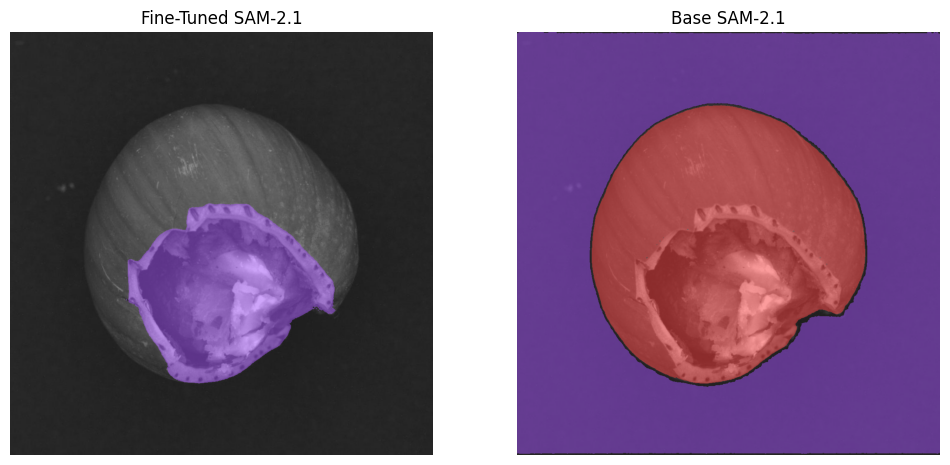

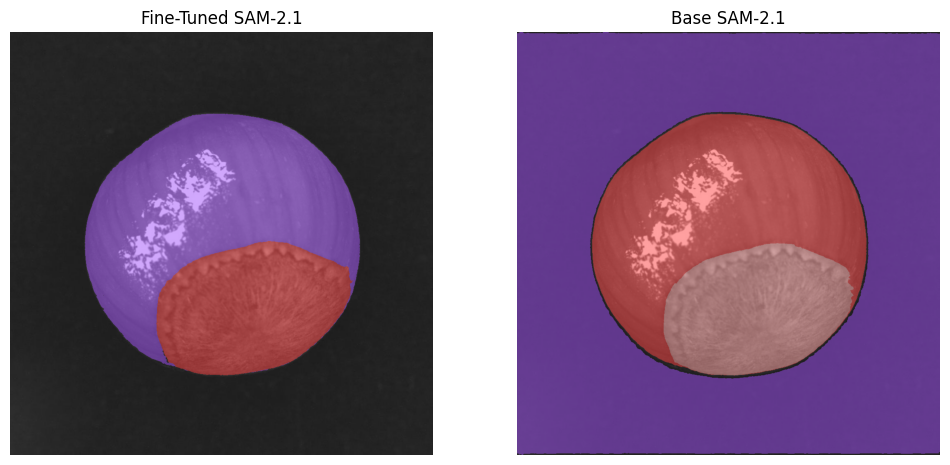

In [13]:
validation_set = os.listdir("/kaggle/working/products_sam-3/valid")
for image in [img for img in validation_set if img.endswith(".jpg")]:
    image_path = os.path.join("/kaggle/working/products_sam-3/valid", image)
    opened_image = np.array(Image.open(image_path))
    result = mask_generator.generate(opened_image)

    detections = sv.Detections.from_sam(sam_result=result)

    mask_annotator = sv.MaskAnnotator(color_lookup = sv.ColorLookup.INDEX)
    annotated_image = opened_image.copy()
    annotated_image = mask_annotator.annotate(annotated_image, detections=detections)

    base_annotator = sv.MaskAnnotator(color_lookup = sv.ColorLookup.INDEX)

    base_result = mask_generator_base.generate(opened_image)
    base_detections = sv.Detections.from_sam(sam_result=base_result)
    base_annotated_image = opened_image.copy()
    base_annotated_image = base_annotator.annotate(base_annotated_image, detections=base_detections)

    sv.plot_images_grid(images=[annotated_image, base_annotated_image], titles=["Fine-Tuned SAM-2.1", "Base SAM-2.1"], grid_size=(1, 2))